In [1]:
import os
import numpy as np
from poseidon.signal.lofar import tpsw, lofar
from poseidon.io.offline import load_raw_data
from poseidon.signal.utils import resample

In [2]:
lofar?

Signature:
lofar(
    data,
    fs,
    n_pts_fft=1024,
    n_overlap=0,
    decimation_rate=3,
    spectrum_bins_left=None,
    **tpsw_args,
)
Docstring: <no docstring>
File:      ~/.virtualenvs/sonar/lib/python3.6/site-packages/poseidon/signal/lofar.py
Type:      function


In [2]:
base_dir = os.path.abspath(os.path.join(os.getcwd(), os.pardir))
database = '24classes'
proc_data_path = os.path.join(base_dir, 'data', 'processed')
raw_data_path = os.path.join(base_dir, 'data', 'raw', database)
raw_data = load_raw_data(raw_data_path, verbose=0)
# raw_data['Class_22']['class22_dataset24B.wav'].fs

In [3]:
final_fs = 22050
n_pts_fft = 2048
n_overlap = 0
decimation_rate = 1

def remove_errors(cls_name, run_name, sonar_dict):
    srate = sonar_dict[cls_name][run_name][1]
    if cls_name == 'Class_15' and run_name == 'class15_dataset24A.wav':
        signal = sonar_dict[cls_name][run_name][0]
        sonar_dict[cls_name][run_name] = (np.concatenate([signal[:srate*32], signal[srate*34:srate*43], signal[srate*47:]]), sonar_dict[cls_name][run_name][1],)
    if cls_name == 'Class_15' and run_name == 'class15_dataset24B.wav':
        del sonar_dict[cls_name][run_name]
    if cls_name == 'Class_11' and run_name == 'class11_dataset24B.wav':
        del sonar_dict[cls_name][run_name]
    if cls_name == 'Class_13' and run_name == 'class13_dataset24C.wav':
        signal = sonar_dict[cls_name][run_name][0]
        sonar_dict[cls_name][run_name] = (np.concatenate([signal[:srate*62], signal[srate*66:]]), sonar_dict[cls_name][run_name][1],)
    if cls_name == 'Class_24' and run_name == 'class24_dataset24B.wav':
        signal = sonar_dict[cls_name][run_name][0]
        sonar_dict[cls_name][run_name] = (signal[:srate*57], sonar_dict[cls_name][run_name][1],)
    if cls_name == 'Class_24' and run_name == 'class24_dataset24B.wav':
        signal = sonar_dict[cls_name][run_name][0]
        sonar_dict[cls_name][run_name] = (signal[:srate*57], sonar_dict[cls_name][run_name][1],)
    if cls_name == 'Class_3' and run_name == 'class3_dataset24.wav':
        del sonar_dict[cls_name][run_name]


    return sonar_dict
        
sonar_dict = (
    raw_data
        .apply(lambda rr: (rr.signal, rr.fs,) if rr.signal.ndim == 1 else (rr.signal.sum(axis=1)/2, rr.fs))
)

for cls_name in sonar_dict.copy():
    for run_name in sonar_dict[cls_name].copy():
        sonar_dict = remove_errors(cls_name, run_name, sonar_dict)
        
# sonar_dict
proc_data = (
    sonar_dict
        .apply(lambda rr: resample(rr[0], rr[1], final_fs = final_fs))
#     .apply(lambda x: lofar(x, fs=final_fs,
#                n_pts_fft = n_pts_fft, 
#                n_overlap=n_overlap, 
#                decimation_rate=1, 
#                spectrum_bins_left=1025))
        .apply(lofar,
               fs=final_fs,
               n_pts_fft = n_pts_fft, 
               n_overlap=n_overlap, 
               decimation_rate=1, 
               spectrum_bins_left=1025)
        .apply(lambda lr: (np.log10(lr[0]), lr[0], lr[2] )) # Sxx, freq, time
)



In [4]:
# [int(cls_name.split('_')[1]) for cls_name, run in proc_data.items() for run_name, (Sxx, _, _) in run.items()]
trgt = np.concatenate([int(cls_name.split('_')[1])*np.ones(Sxx.shape[0]) 
                 for cls_name, run in proc_data.items() 
                 for run_name, (Sxx, _, _) in run.items()])

In [5]:
data = np.concatenate([ Sxx
                 for cls_name, run in proc_data.items() 
                 for run_name, (Sxx, _, _) in run.items()], axis=0)
data.shape

(36460, 1025)

In [8]:
import joblib
joblib.dump((data, trgt,), os.path.join(proc_data_path, '24_classes_clean_no_errors_2048_22050.jbl'))

['/home/pedro/Workspace/lps/deep_water_sonar_nn/data/processed/24_classes_clean_no_errors_2048_22050.jbl']

Class_22	class22_dataset24B.wav


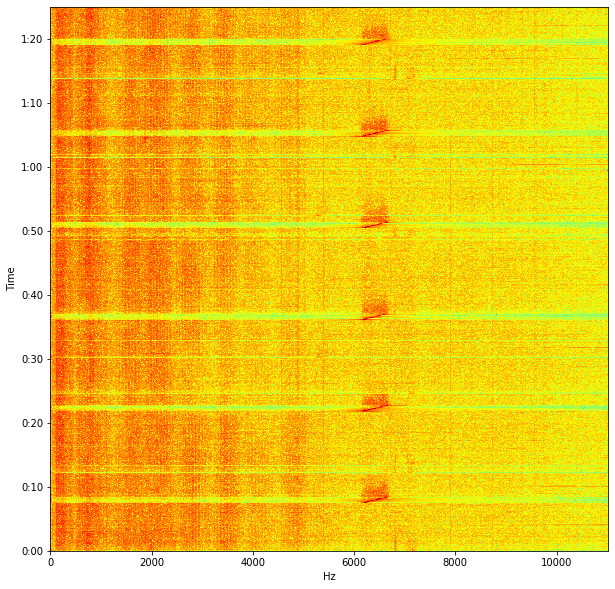

Class_22	class22_dataset24A.wav


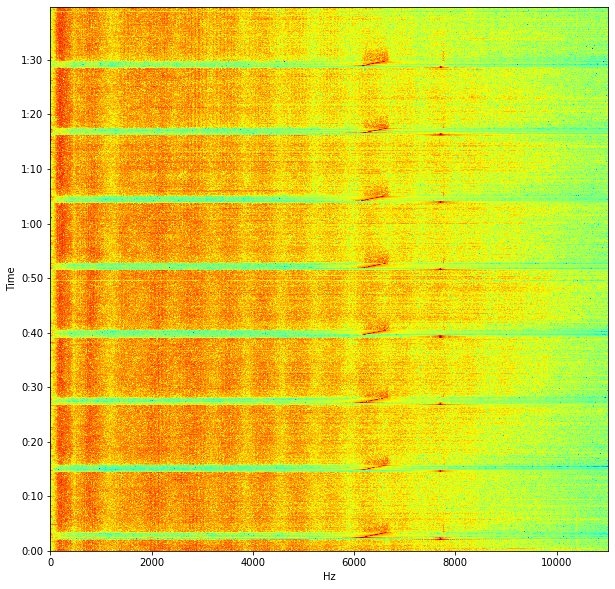

Class_18	class18_dataset24.wav


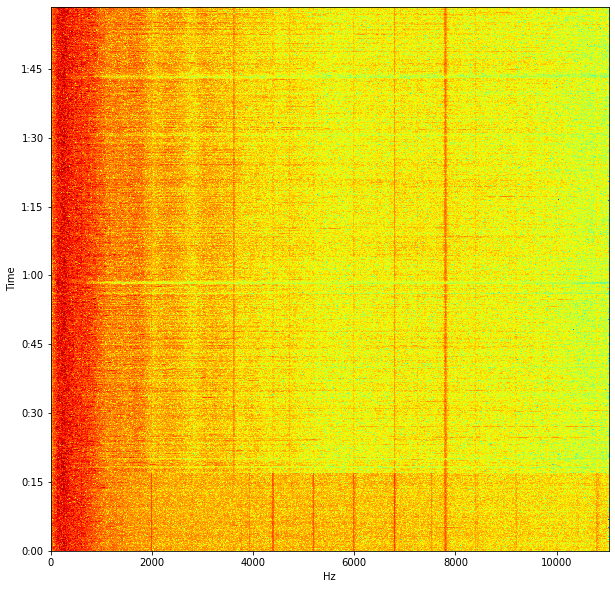

Class_16	class16_dataset24B.wav


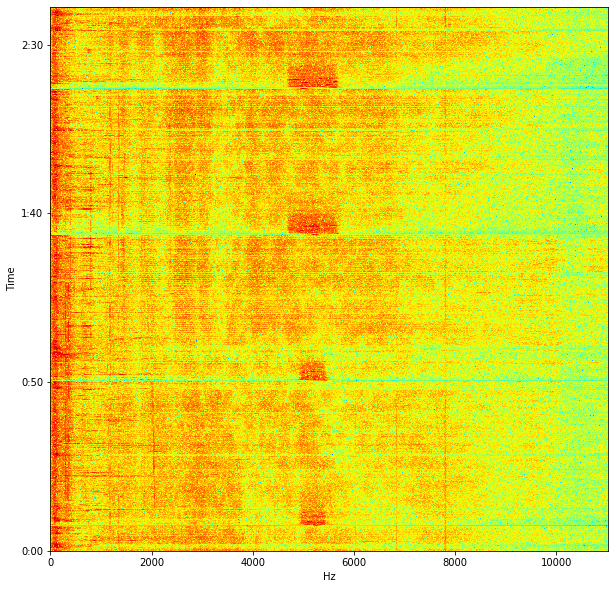

Class_16	class16_dataset24A.wav


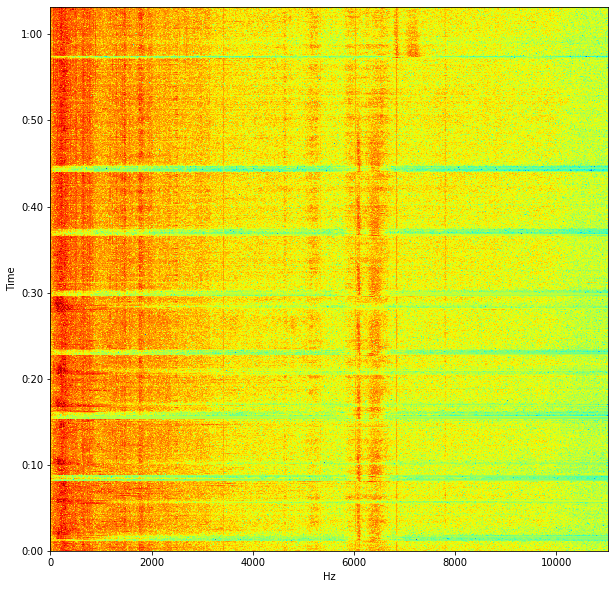

Class_23	class23_dataset24A.wav


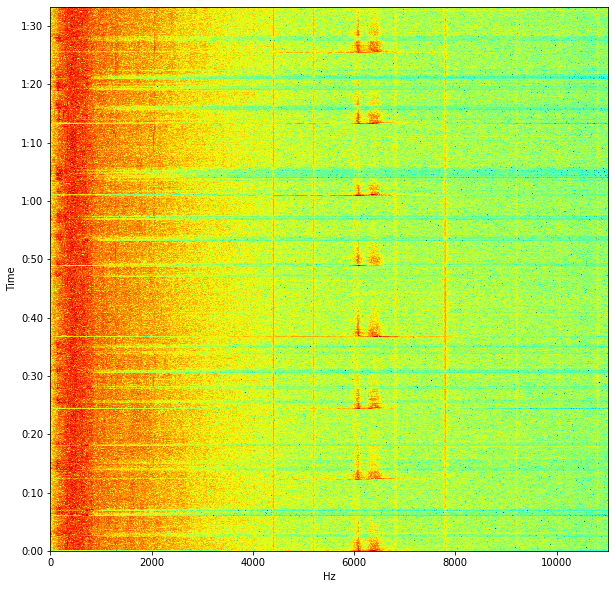

Class_23	class23_dataset24C.wav


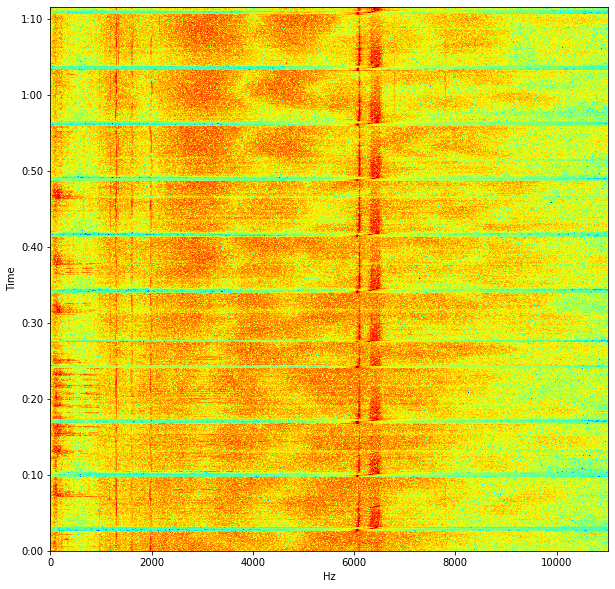

Class_23	class23_dataset24B.wav


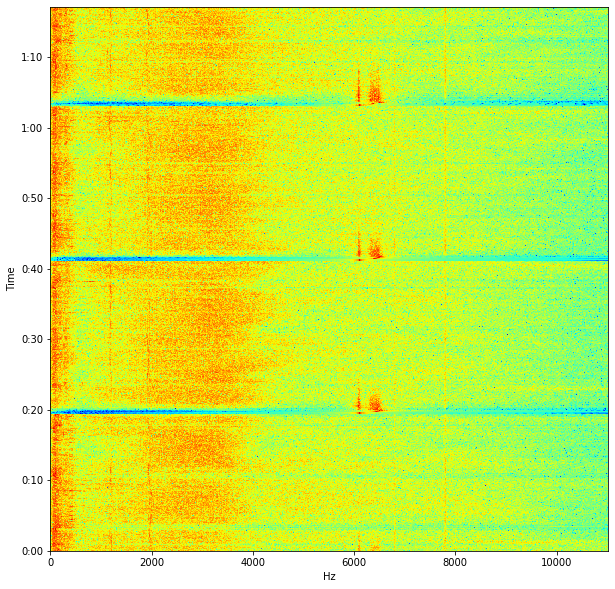

Class_17	class17_dataset24A.wav


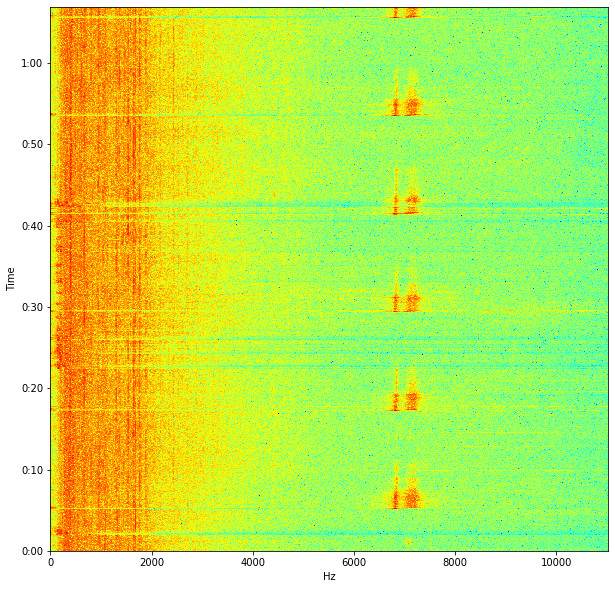

Class_17	class17_dataset24B.wav


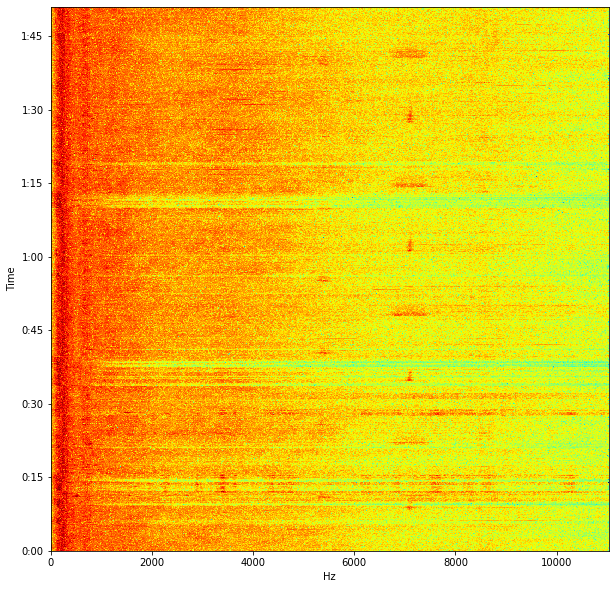

Class_15	class15_dataset24A.wav


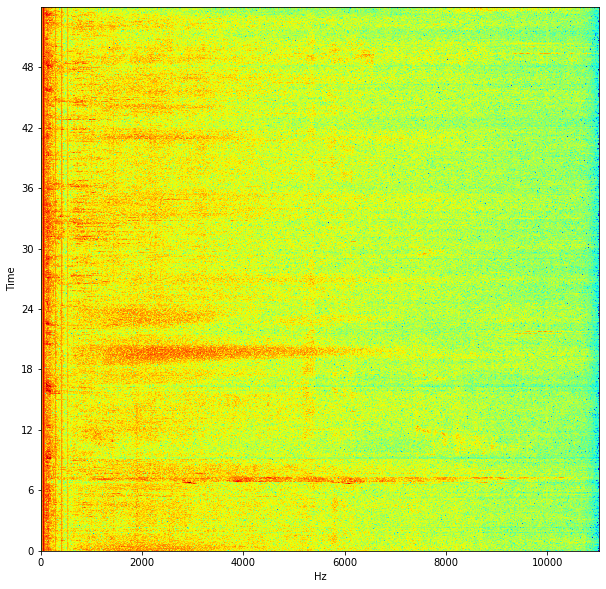

Class_11	class11_dataset24A.wav


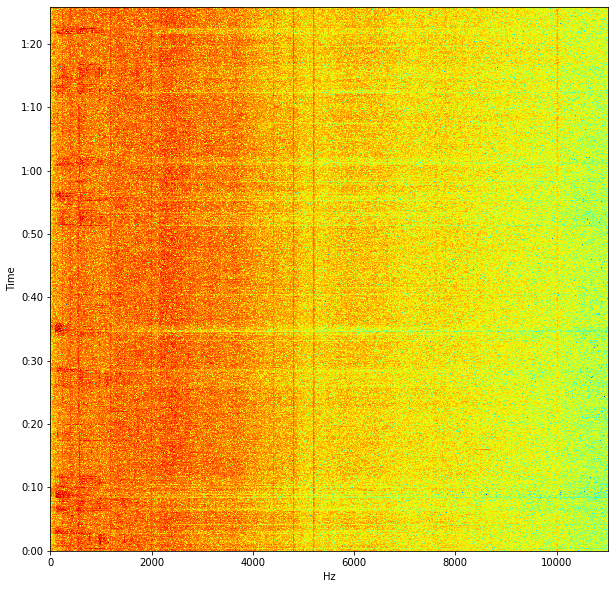

Class_20	class20_dataset24.wav


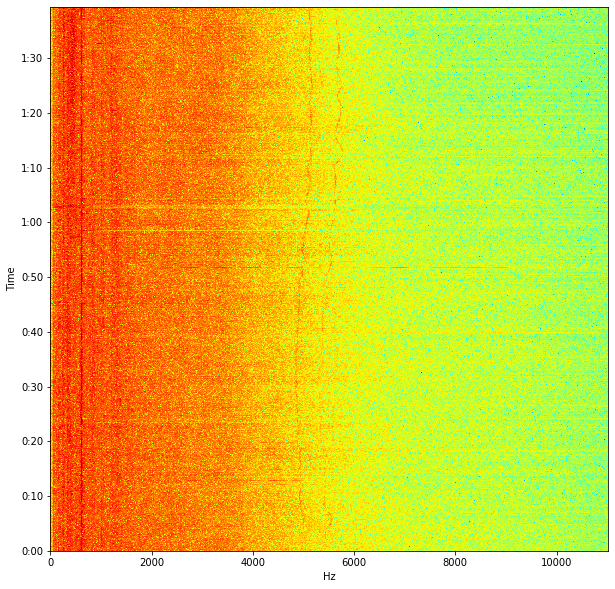

Class_8	class8_dataset24A.wav


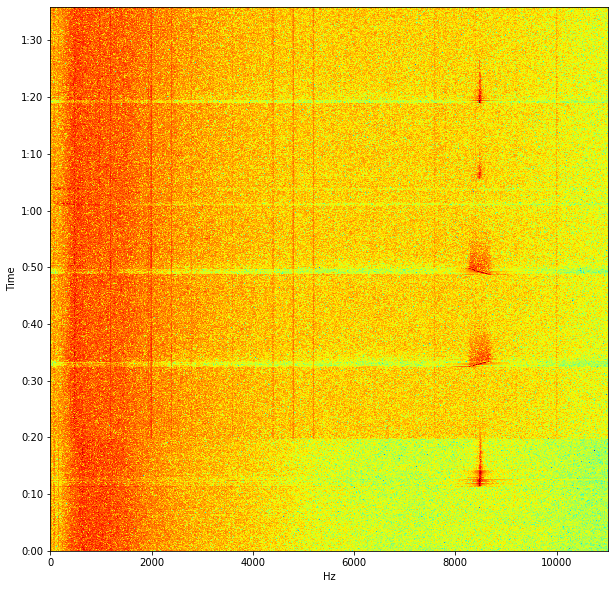

Class_8	class8_dataset24B.wav


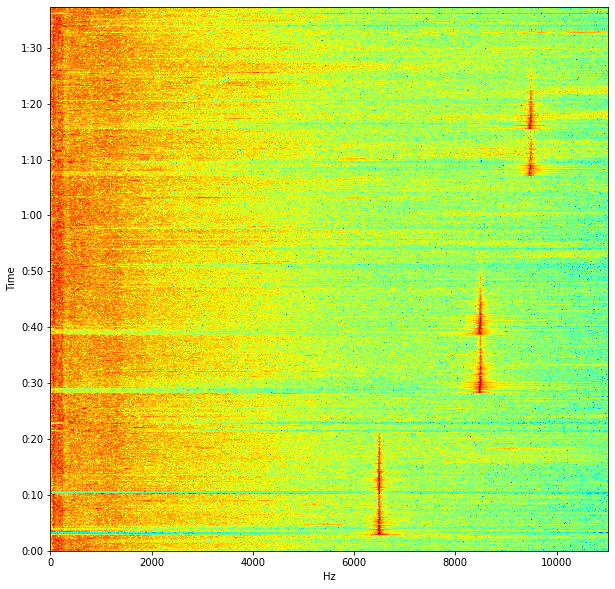

Class_5	class5_dataset24C.wav


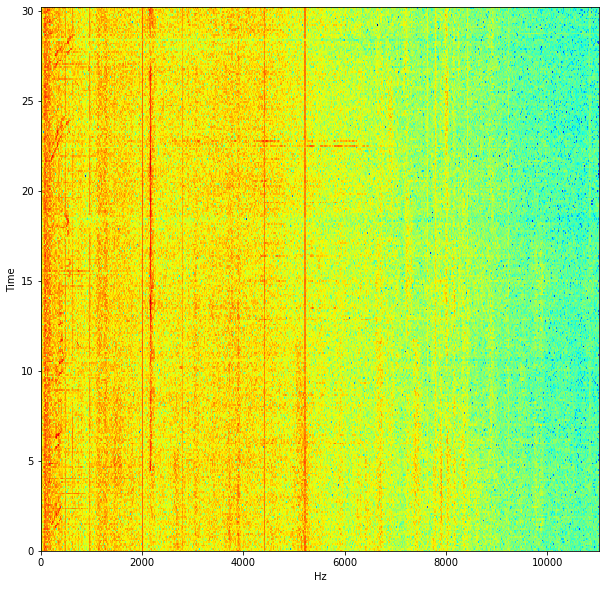

Class_5	class5_dataset24A.WAV


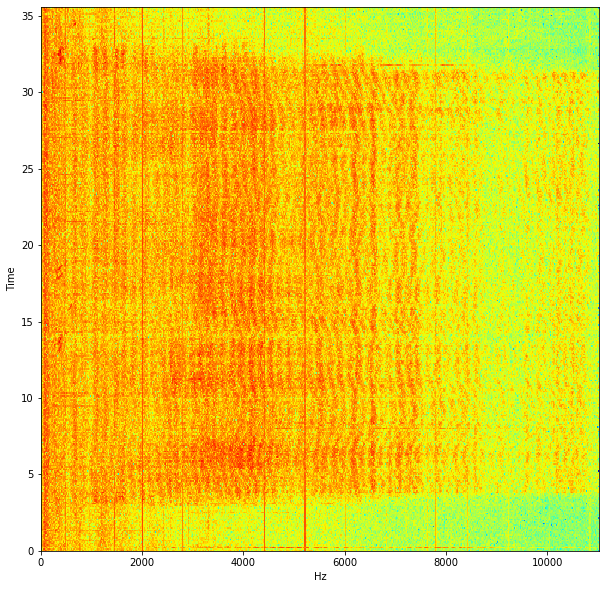

Class_5	class5_dataset24D.wav


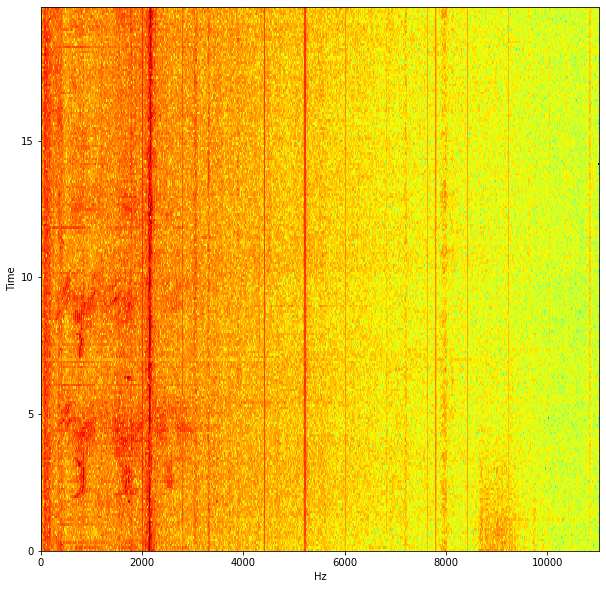

Class_5	class5_dataset24B.WAV


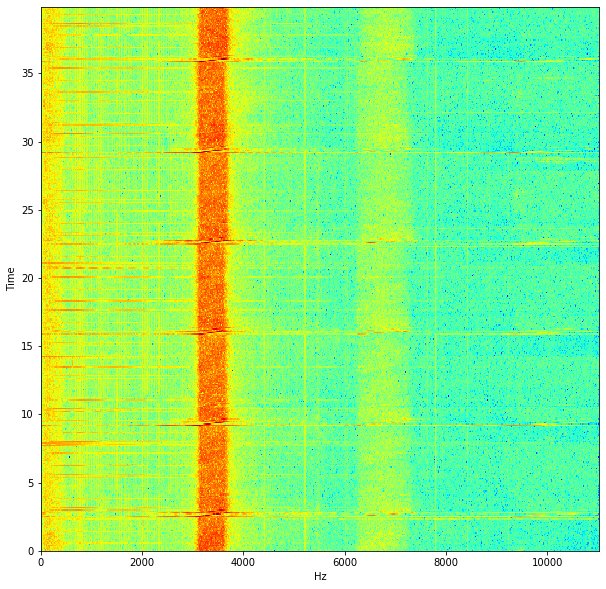

Class_9	class9_dataset24.wav


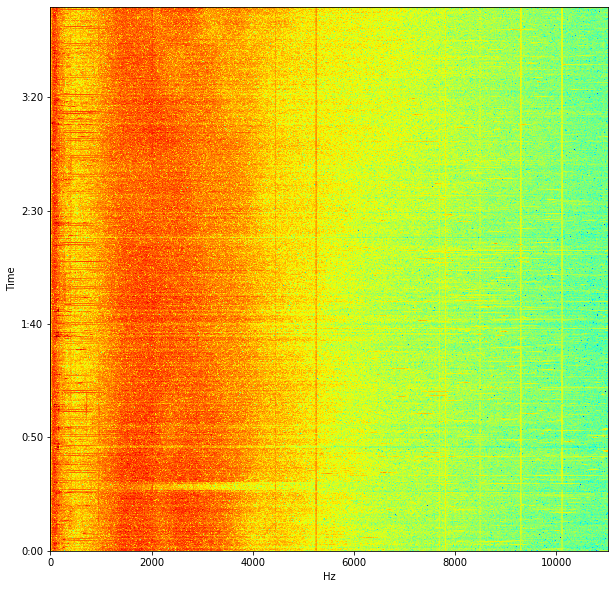

Class_6	class6_dataset24.wav


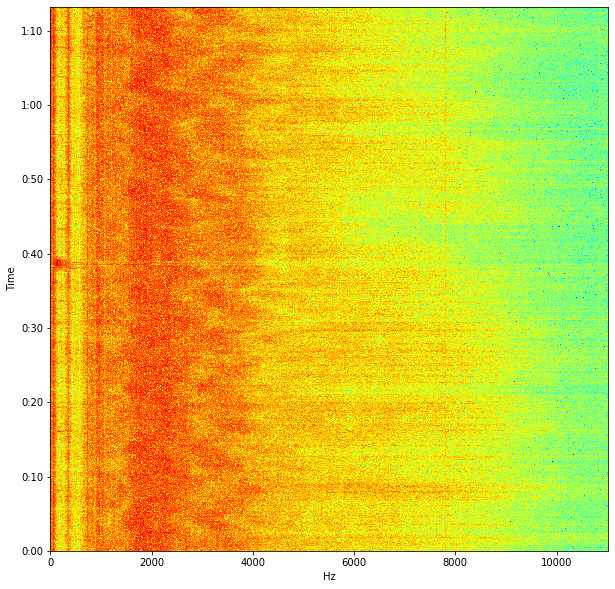

Class_21	class21_dataset24B.wav


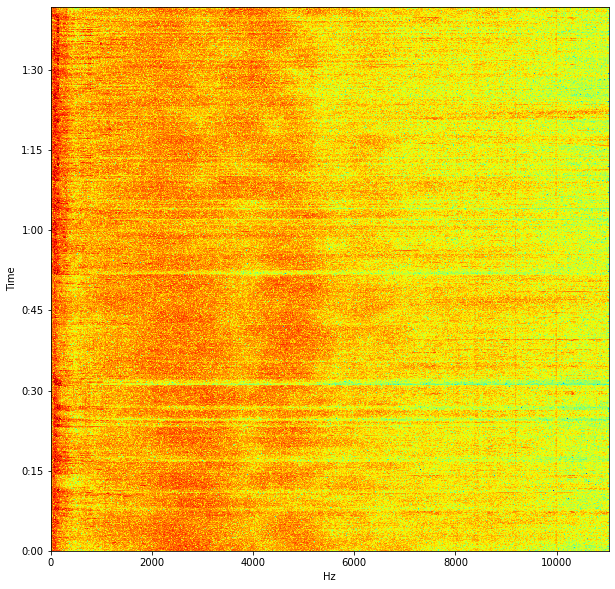

Class_21	class21_dataset24A.wav


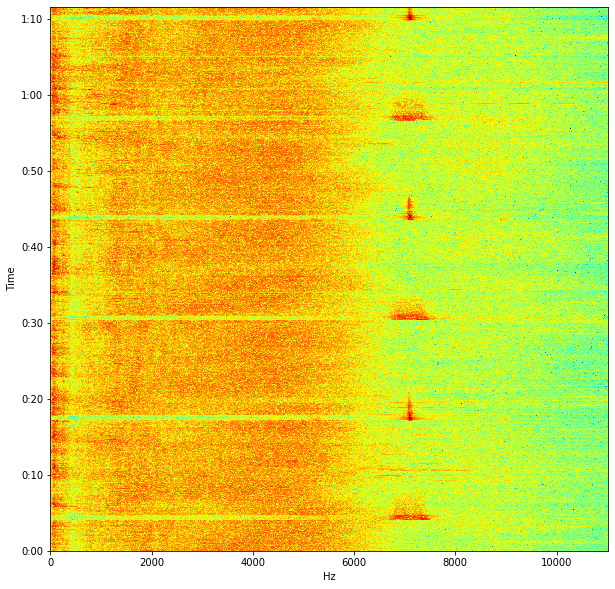

Class_14	class14_dataset24A.wav


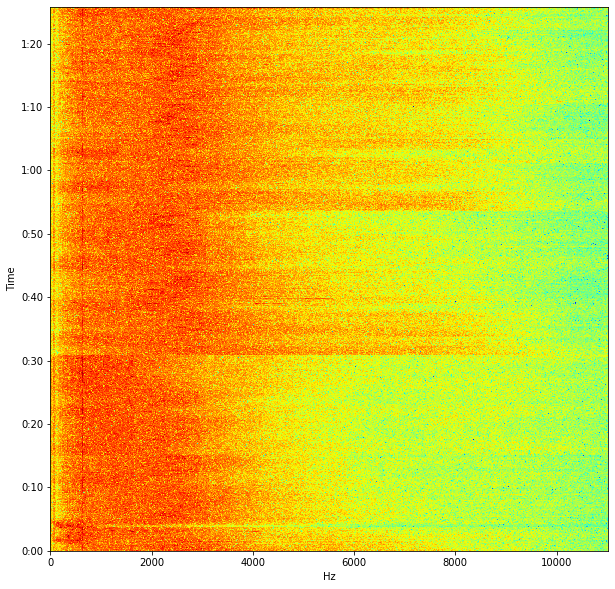

Class_14	class14_dataset24B.wav


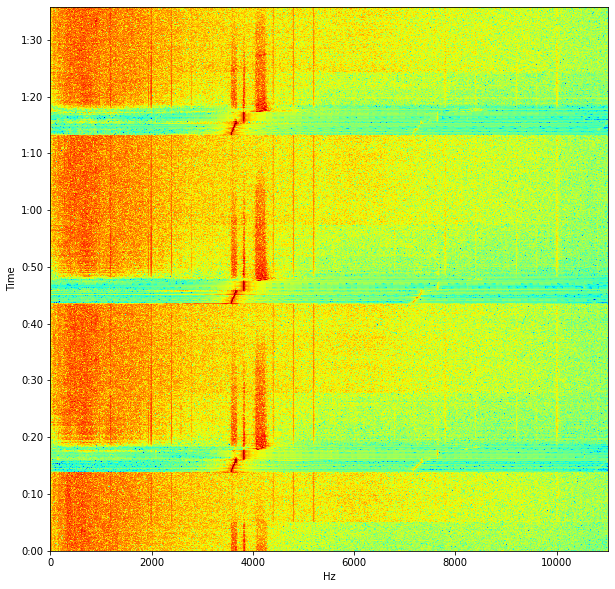

Class_4	class4_dataset24.wav


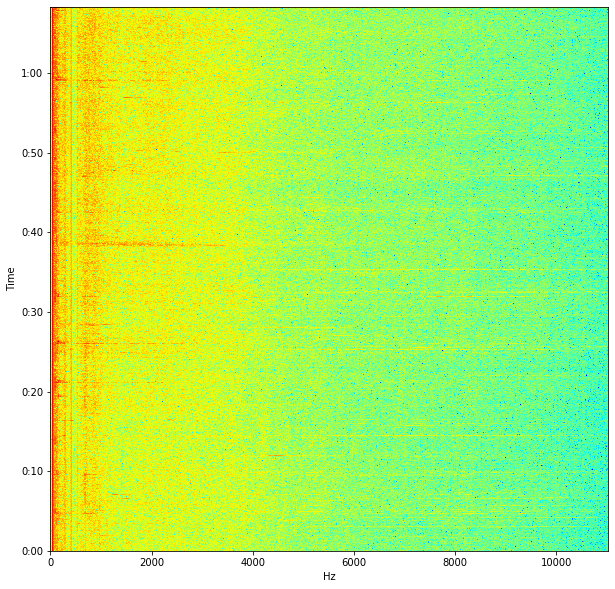

Class_7	class7_dataset24B.wav


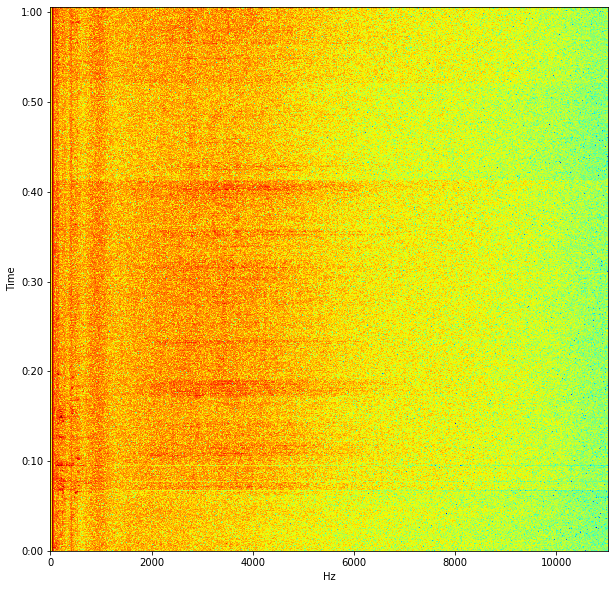

Class_7	class7_dataset24A.wav


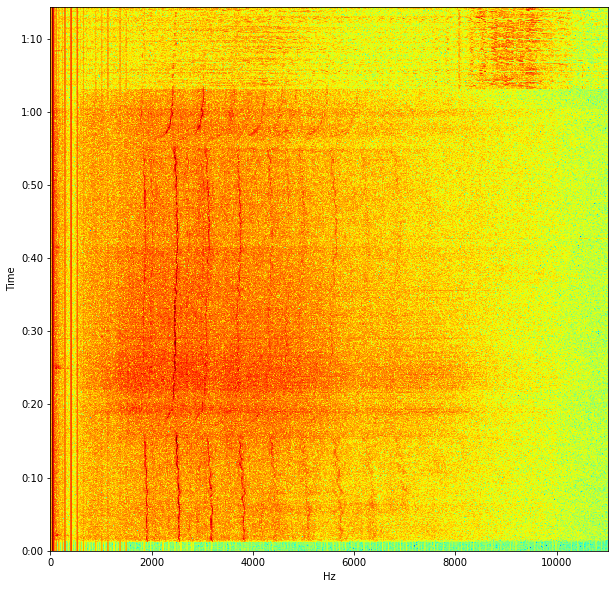

Class_10	class10_dataset24A.wav


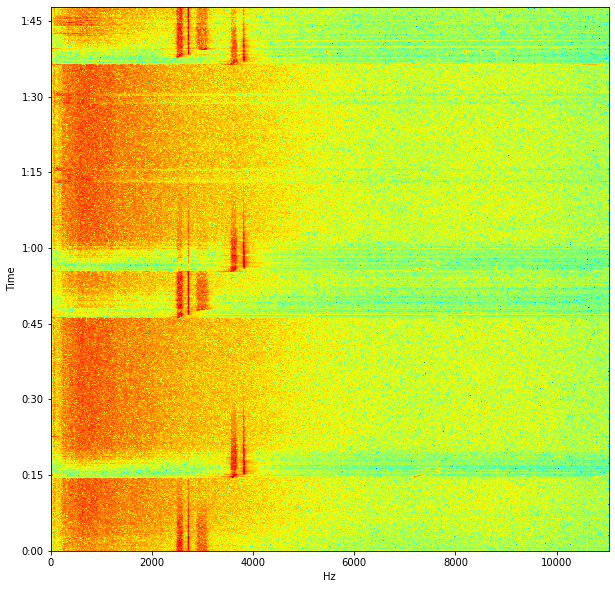

Class_10	class10_dataset24B.wav


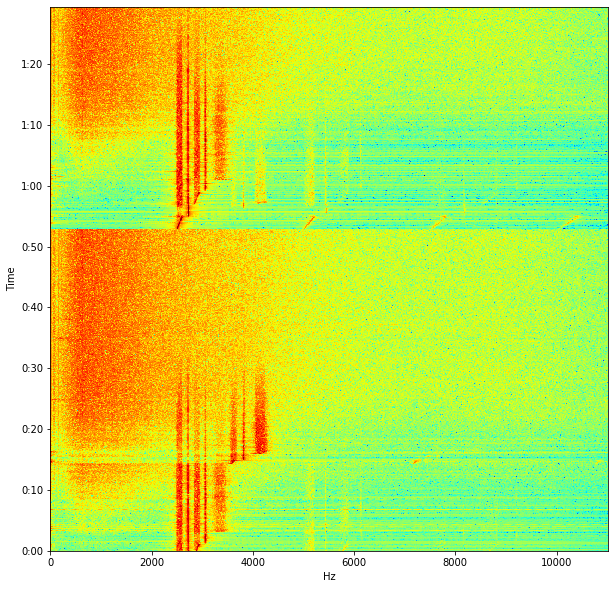

Class_19	class19_dataset24A.wav


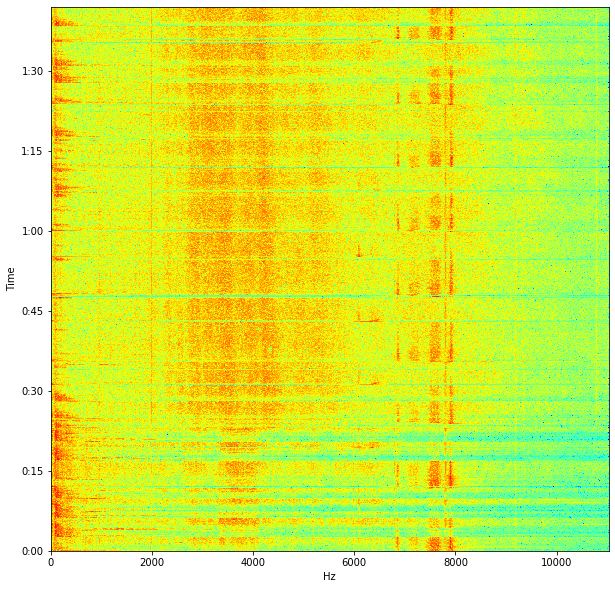

Class_19	class19_dataset24B.wav


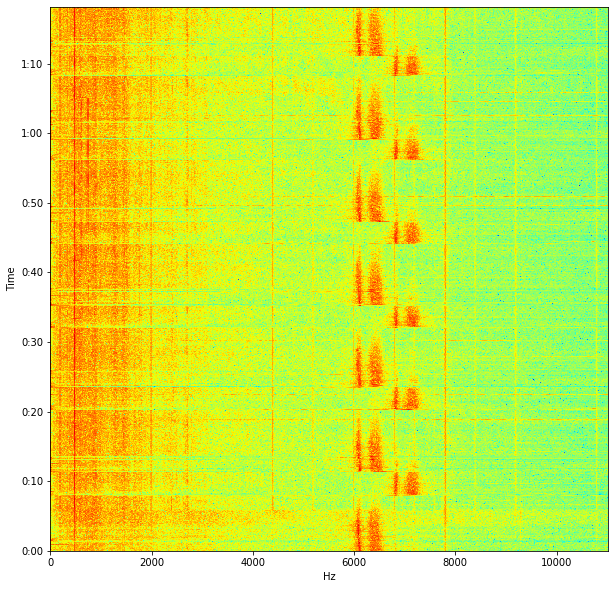

Class_2	class2_dataset24.wav


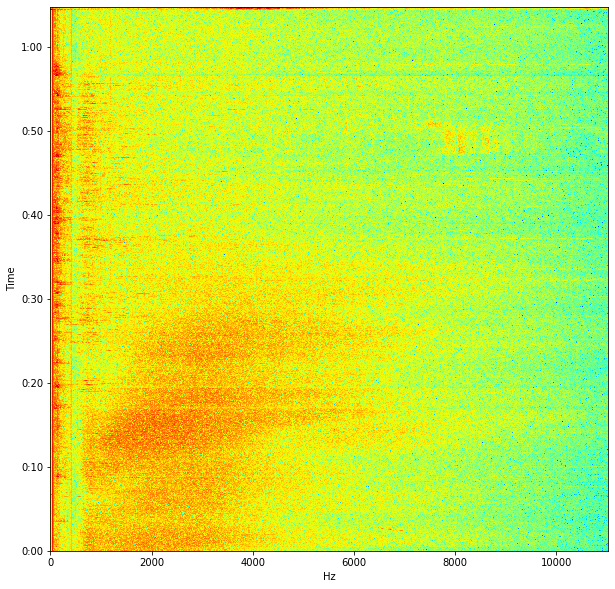

Class_1	class1_dataset24.wav


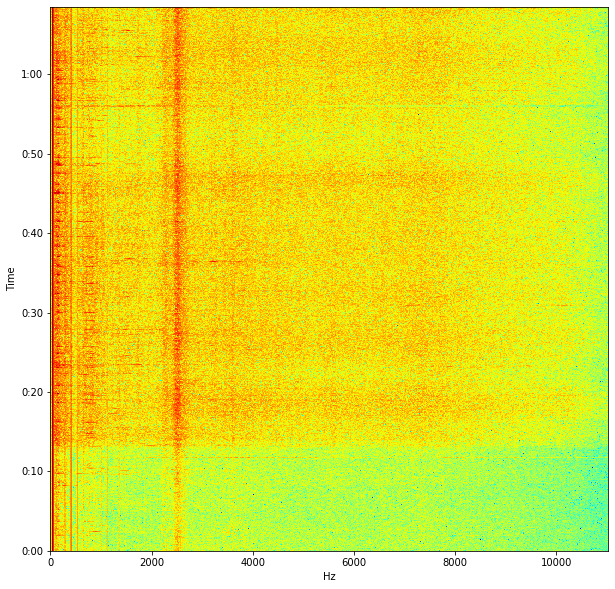

Class_13	class13_dataset24C.wav


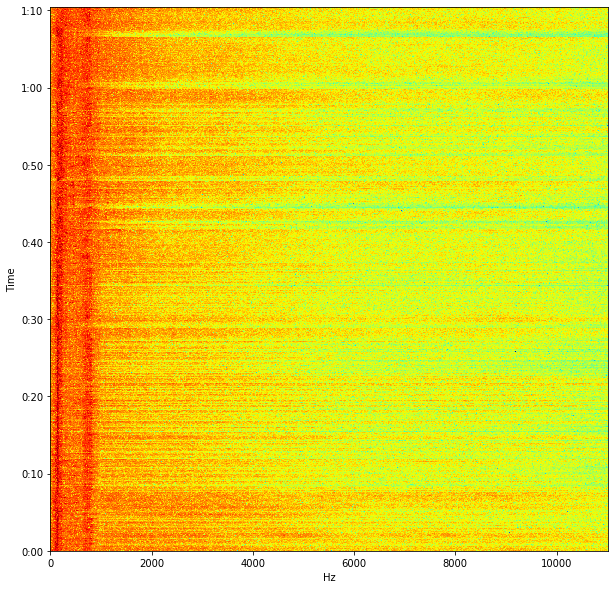

Class_13	class13_dataset24B.wav


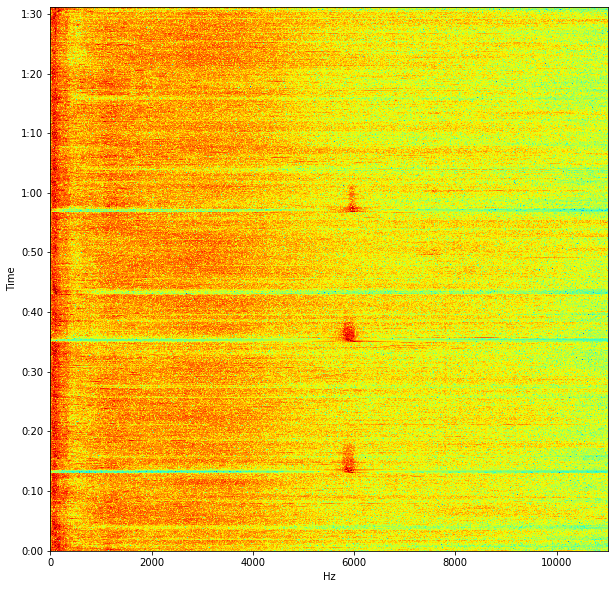

Class_13	class13_dataset24A.wav


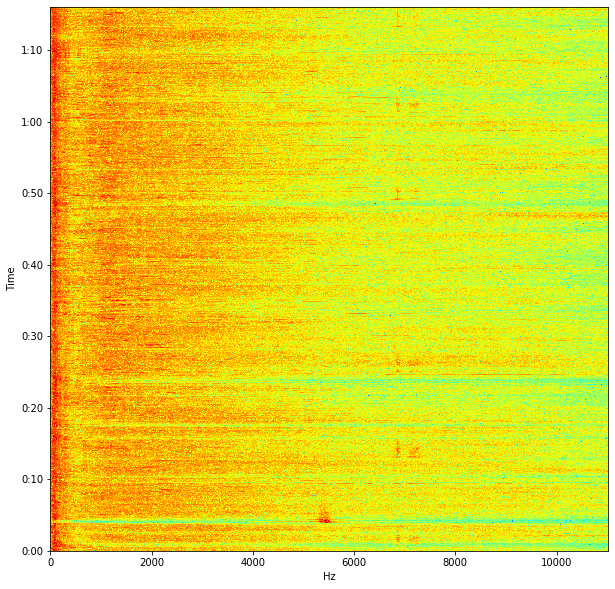

Class_12	class12_dataset24.wav


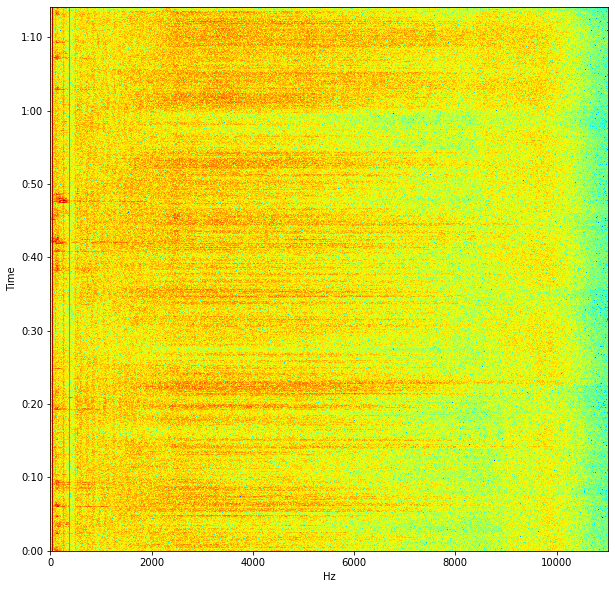

Class_24	class24_dataset24C.wav


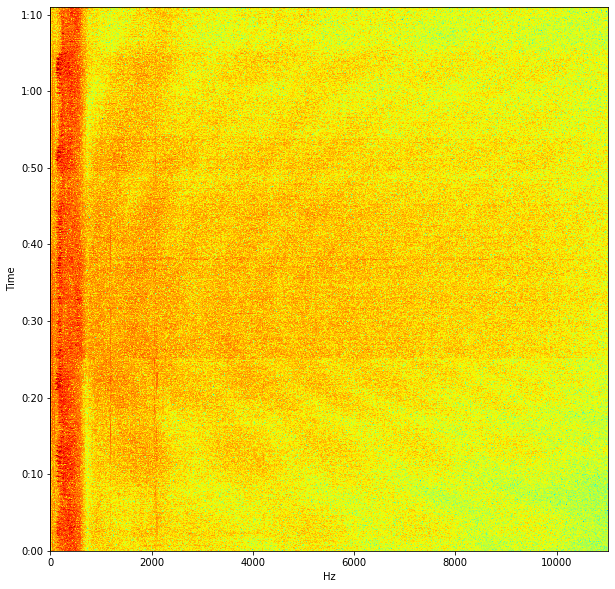

Class_24	class24_dataset24A.wav


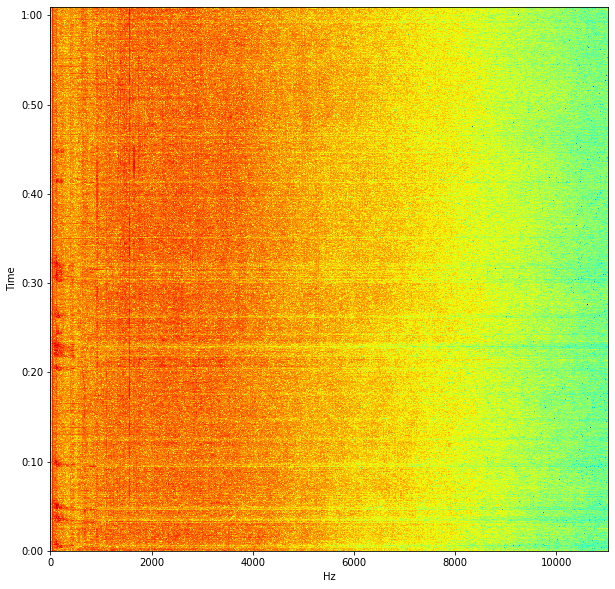

Class_24	class24_dataset24B.wav


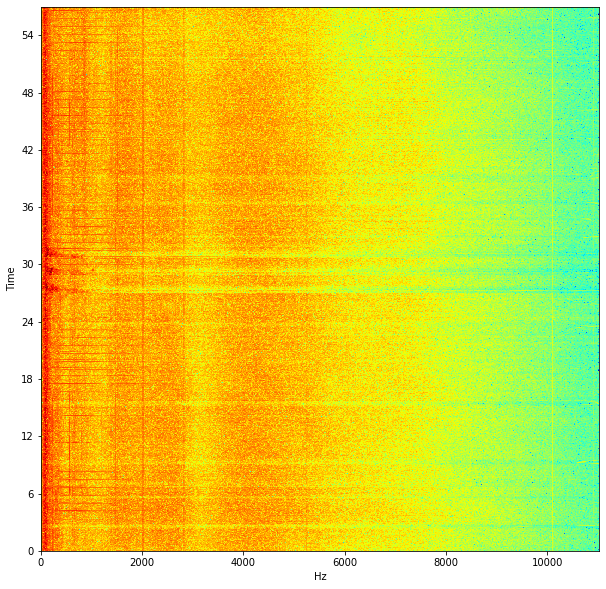

In [7]:
from librosa.display import specshow
import matplotlib.pyplot as plt
for cls, run in proc_data.items():
    for run_name, (Sxx, _, _) in run.items():
        fig, ax = plt.subplots(figsize=(10,10))
        print(cls, end='\t')
        print(run_name)
        specshow(Sxx, x_axis='linear', y_axis='time', sr=final_fs, hop_length=n_pts_fft, cmap='jet',ax=ax)
        plt.show()
# len(raw_data['Class_22']['class22_dataset24B.wav'][1]) # Sxx ,freq, time

In [6]:
len(raw_data['Class_22']['class22_dataset24B.wav'])

0

In [10]:
model = build_net((800,), 24,n_neurons=[15], n_activations=['tanh'])
model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 15)                12015     
_________________________________________________________________
dense_9 (Dense)              (None, 24)                384       
Total params: 12,399
Trainable params: 12,399
Non-trainable params: 0
_________________________________________________________________


In [12]:
model = build_net((800,), 24,n_neurons=[15, 15], n_activations=['tanh', 'tanh'])
model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 15)                12015     
_________________________________________________________________
dense_14 (Dense)             (None, 15)                240       
_________________________________________________________________
dense_15 (Dense)             (None, 24)                384       
Total params: 12,639
Trainable params: 12,639
Non-trainable params: 0
_________________________________________________________________


In [13]:
model = build_net((800,), 24,n_neurons=[15, 15, 15], n_activations=['tanh', 'tanh'])
model.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, 15)                12015     
_________________________________________________________________
dense_17 (Dense)             (None, 15)                240       
_________________________________________________________________
dense_18 (Dense)             (None, 24)                384       
Total params: 12,639
Trainable params: 12,639
Non-trainable params: 0
_________________________________________________________________
